In [1]:
%load_ext lab_black

In [2]:
import io
import json
from datetime import date

import altair as alt
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import requests
from sklearn.cluster import SpectralClustering
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import pairwise_distances_argmin
from tslearn.clustering import KShape
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

alt.data_transformers.disable_max_rows()

C:\Users\AbboodA\AppData\Local\Continuum\miniconda3\envs\reporting\lib\site-packages\tslearn\bases\bases.py:15: UserWarning: h5py not installed, hdf5 features will not be supported.
Install h5py to use hdf5 features: http://docs.h5py.org/
  warn(h5py_msg)


DataTransformerRegistry.enable('default')

# Reporting behavior during COVID-19 pandemic using WHO's [dashboard](https://covid19.who.int/)
In this notebook, I examine WHO's data to find out how reporting behavior differs between countries. I will look at how frequently countries report and how case numbers are distributed during the week. To answer these questions, I am going to categorize different reporting behaviors using clustering methods and a self-developed metric.

### Project Overview
The project tackles the problem of reporting delays of confirmed cases of COVID-19 which is highly heterogeneous if looked at from a global perspective. Public health officials, however, rely heavily on data such as provided by WHO and need to consider country-specific reporting issues to make assessments based on WHO's data more reliable. Data quality and reporting delays might differ due to many reasons such as lower testing capacities, slow contact tracing, corrupt governments, etc. Although these issues cannot be identifed from the data, this project tries to classify countries' reliabilty based on their reporting behavior alone which helps us subsequently estimate their reporting reliability.

### Problem Statement
How is reporting reliability usually measured? In an ideal setting, the data that we use to make decisions comes with two timestamps. One is the infection date and the other is the reporting date. When we take the average difference of these two values on a case-level, we get an estimate on the reporting delay. Afterwards, we can find reasons for these delays. This information is, however, not provided by WHO's COVID-19 data. Additionally, it might be questionable if each country even has the capacities to investigate the infection date. Therefore, the standard approach is not feasabile.

Thus, I will need to solve this problem by defining an surrogate question. Can we describe the reporting behavior of countries more broadly? When looking at the data and from experience, it is known that reporting of cases is usually lower during weekends and holidays. Some countries even only report once per week due to. Hence, we try to answer how reporting varies along the week and pre country. This questions can be split into two further questions: When does a country tend to report new cases (I shall call this _binary reporting behavior_) and how does the weekly amount of cases distribute on the single weekdays (I shall call this _relative reporting behavior_).

### Metrics
To answer these questions, I will use descriptive statistics weekday statistics of the binary and relative reporting behavior. I will display error bars to get an estimate of the confidence of the statistics. I expect to uncover lowered reporting during weekends which should be more pronounced the less reliable the reporting of a country is. High variance in the relative reporting behavior is also expected with countries that have a lower reporting reliability. I will user clustering methods to examine if the binary and relative reporting follows few, salient patterns across all countries. We will not use clustering metrics, since we use spectral clustering which might yield non-dense, close clusters that are not favoured by most clustering metrics. Since we will only look at a few clusters, we will inspect the cluster quality visually.

## Load and transform data
Data only has ISO2 codes. These are replaced with full country names. The data contains no missing values which makes transformation easy. Default settings of pandas `read_csv` remove Namibia from the data set which needs to be switched off. Also, JSON is in unsual format which made loading a little tricky. I, furthermore, derived a population count from the data.

In [3]:
def load_country_codes() -> pd.DataFrame:
    """Load ISO-2 country codes with respective full country name."""
    return (
        pd.read_csv(
            io.StringIO(
                requests.get(
                    "https://raw.githubusercontent.com/lukes/ISO-3166-Countries-with-Regional-Codes/master/all/all.csv",
                    proxies={"https": "*****"},
                ).text
            ),
            keep_default_na=False,
        )
        .loc[:, ["name", "alpha-2"]]
        .append(
            pd.DataFrame(
                {
                    "alpha-2": ["XA", "XB", "XC", "XK"],
                    "name": [
                        "Bonaire",
                        "Sint Eustatius",
                        "Saba",
                        "Kosovo",
                    ],  # Missing country codes taken from https://covid19.who.int/info/
                }
            )
        )
    )

In [4]:
def load_data() -> pd.DataFrame:
    """Loads data from WHO's COVID-19 dashboard and transforms it.

    Returns:
        pd.DataFrame: Loaded and transformed COVID-19 data in long format.
    """
    country_codes = load_country_codes()

    response = requests.get(
        "https://covid19.who.int/who-data/countries-by-day.json",
        proxies={"https": "*****"},
    )
    who_json = json.loads(response.content.decode("utf-8"))
    columns = who_json["dimensions"] + who_json["metrics"]
    columns = [column["name"] for column in columns]

    return (
        pd.DataFrame(who_json["rows"], columns=columns)
        .astype(
            {
                "Country": "string",
                "Region": "string",
            }
        )
        .assign(
            day=lambda x: pd.to_datetime(x.day / 1000, unit="s"),
            population=lambda x: 1 / (x["WkCasePop"] / 100000 / x["Cases Last 7 Days"]),
        )
        .query("day < @pd.to_datetime('2021-05-14')")  # To make results reproducable
        .rename(columns={"Country": "ISO2"})
        .dropna()  # Removes 'other' countries that have no ISO2 code
        .sort_values(by=["day", "ISO2"])
        .reset_index(drop=True)
        .merge(
            country_codes,
            left_on="ISO2",
            right_on="alpha-2",
            how="left",
            validate="m:1",
        )
    )

In [5]:
df = load_data()
df.isna().sum()

day                            0
ISO2                           0
Region                         0
Deaths                         0
Cumulative Deaths              0
Deaths Last 7 Days             0
Deaths Last 7 Days Change      0
Deaths Per Hundred Thousand    0
Confirmed                      0
Cumulative Confirmed           0
Cases Last 7 Days              0
Cases Last 7 Days Change       0
Cases Per Hundred Thousand     0
WkCasePop                      0
WkDeathPop                     0
population                     0
name                           0
alpha-2                        0
dtype: int64

There is no missing data. However, exact counts of confirmed cases and deaths is to be assessed and unequals missing data.

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 85718 entries, 0 to 85717
Data columns (total 18 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   day                          85718 non-null  datetime64[ns]
 1   ISO2                         85718 non-null  object        
 2   Region                       85718 non-null  string        
 3   Deaths                       85718 non-null  int64         
 4   Cumulative Deaths            85718 non-null  int64         
 5   Deaths Last 7 Days           85718 non-null  int64         
 6   Deaths Last 7 Days Change    85718 non-null  float64       
 7   Deaths Per Hundred Thousand  85718 non-null  float64       
 8   Confirmed                    85718 non-null  int64         
 9   Cumulative Confirmed         85718 non-null  int64         
 10  Cases Last 7 Days            85718 non-null  int64         
 11  Cases Last 7 Days Change     85718 non-nu

In [7]:
df.name.nunique()

222

## Binary reporting behavior
First, we look at the reporting behavior of countries during the pandemic by only quantifying whether a country made a report or not. We will look at reporting behavior stratified by weekday and several spatial break-ups, namely global, by region, and by country.

In [8]:
# Prepare data for binary reporting behavior
day_stat = df.assign(
    reported=lambda x: np.where(x["Confirmed"] > 0, 1, 0),
    weekday=lambda x: x["day"].dt.day_name(),
    week=lambda x: x["day"].dt.isocalendar().week,
).loc[
    :,
    [
        "Region",
        "Confirmed",
        "name",
        "reported",
        "day",
        "weekday",
        "week",
        "WkCasePop",
    ],
]

In [9]:
day_stat.head()

,Region,Confirmed,name,reported,day,weekday,week,WkCasePop
0,WPRO,1,China,1,2020-01-04,Saturday,1,0.0
1,WPRO,0,China,0,2020-01-05,Sunday,1,0.0
2,WPRO,3,China,1,2020-01-06,Monday,2,0.0
3,WPRO,0,China,0,2020-01-07,Tuesday,2,0.0
4,WPRO,0,China,0,2020-01-08,Wednesday,2,0.0


### Binary reporting, globally

In [10]:
global_reporting = (
    day_stat.query("Region.notna()")
    .groupby(["name", "weekday"])
    .agg({"reported": "mean"})
    .reset_index()
)
global_reporting.head()

,name,weekday,reported
0,Afghanistan,Friday,0.919355
1,Afghanistan,Monday,0.888889
2,Afghanistan,Saturday,0.920635
3,Afghanistan,Sunday,0.920635
4,Afghanistan,Thursday,0.920635


In [11]:
error_bars = (
    alt.Chart(global_reporting)
    .mark_errorbar(extent="stdev")
    .encode(
        y=alt.Y(
            "reported",
            scale=alt.Scale(zero=False),
        ),
        x=alt.X(
            "weekday:N",
            sort=[
                "Monday",
                "Tuesday",
                "Wednesday",
                "Thursday",
                "Friday",
                "Saturday",
                "Sunday",
            ],
        ),
    )
).properties(width=400, height=400)

points = (
    alt.Chart(global_reporting)
    .mark_point(filled=True, color="black")
    .encode(
        x=alt.X(
            "weekday:N",
            sort=[
                "Monday",
                "Tuesday",
                "Wednesday",
                "Thursday",
                "Friday",
                "Saturday",
                "Sunday",
            ],
        ),
        y=alt.Y(
            "reported",
            aggregate="mean",
            title="Average reporting rate",
        ),
    )
).properties(width=400, height=400)

global_reporting_plot = (error_bars + points).properties(
    title="Global reporting rate per weekday"
)
global_reporting_plot.save("figures/global_reporting_rate.png", webdriver="firefox")
global_reporting_plot

alt.LayerChart(...)

There is a high variablity in the reporting rate. How can this be explained? Let's look at the distribution from another perspective. I will simplfy the data from above by binarizing reporting into countries that have an average reporting rate below 50% and grater equals 50% to explain the large error bar from above.

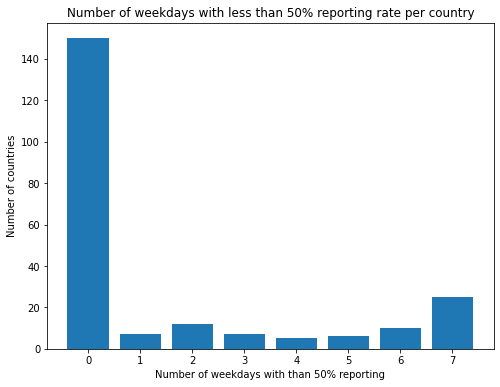

In [12]:
report_behavior_binarized = (
    day_stat.query("Region.notna()")
    .groupby(["name", "weekday"])
    .agg({"reported": "mean"})
    .reset_index()
    .assign(reported=lambda x: x["reported"] < 0.5)
    .groupby("name")
    .agg({"reported": "sum"})
    .values
)

bin_, counts = np.unique(
    report_behavior_binarized,
    return_counts=True,
)

figure, ax = plt.subplots()
figure.set_size_inches(8, 6)
ax.bar(bin_, counts)
ax.set_ylabel("Number of countries")
ax.set_xlabel("Number of weekdays with than 50% reporting")
ax.set_title("Number of weekdays with less than 50% reporting rate per country")
plt.savefig("figures/binary_stat_world_weekady_2.png")
plt.show()

High variabilty can be explained by dichotome reporting behavior. The largest group of countries in average reports on every weekday with a reporting rate above 50%. The second largest group has a reporting rate of less than 50% on all weekdays. The rest of the countries is distributed between 1-6 days days with less than 50% reporting rate.

### Binary reporting, regionally

In [13]:
error_bars = (
    alt.Chart()
    .mark_errorbar(extent="stdev", clip=True)
    .encode(
        x=alt.X(
            "weekday",
            sort=[
                "Monday",
                "Tuesday",
                "Wednesday",
                "Thursday",
                "Friday",
                "Saturday",
                "Sunday",
            ],
        ),
        y=alt.Y("reported", scale=alt.Scale(domain=[0, 1])),
    )
)

points = (
    alt.Chart()
    .mark_point(filled=True)
    .encode(
        x=alt.X(
            "weekday",
            sort=[
                "Monday",
                "Tuesday",
                "Wednesday",
                "Thursday",
                "Friday",
                "Saturday",
                "Sunday",
            ],
        ),
        y=alt.Y("mean(reported)", scale=alt.Scale(domain=[0, 1])),
    )
)

line = (
    alt.Chart(pd.DataFrame({"reported": [0.5]}))
    .mark_rule(color="red")
    .encode(y="reported")
)

regional_reporting_rate = alt.layer(
    points,
    error_bars,
    line,
    data=day_stat.query("Region.notna()").loc[:, ["weekday", "Region", "reported"]],
).facet("Region:N", columns=3)
regional_reporting_rate.save(
    "figures/binary_reporting_regional.png", webdriver="firefox"
)
regional_reporting_rate

alt.FacetChart(...)

The large error bars seem to be contributed by different regions in different amounts. While the spread in Europe, Sout-East Asia, and the Eastern-Mediterranean is smaller, all the more higher it is in Africa, America, and the Western-Pacific. 

In [14]:
region_incidence = (
    alt.Chart(
        day_stat.query("Region.notna()").loc[:, ["weekday", "Region", "WkCasePop"]]
    )
    .transform_calculate(
        order="{'Monday': 0, 'Tuesday': 1, 'Wednesday': 2, 'Thursday': 3, 'Friday': 4, 'Saturday': 5, 'Sunday': 6}[datum.weekday]"
    )
    .mark_line(point=True)
    .encode(
        x=alt.X(
            "weekday",
            sort=[
                "Monday",
                "Tuesday",
                "Wednesday",
                "Thursday",
                "Friday",
                "Saturday",
                "Sunday",
            ],
        ),
        y=alt.Y("mean(WkCasePop)", title="Average 7-day incidence"),
        color="Region",
        order="order:Q",
    )
).properties(width=400, height=400)

region_reporting = (
    alt.Chart(
        day_stat.query("Region.notna()").loc[:, ["weekday", "Region", "reported"]]
    )
    .transform_calculate(
        order="{'Monday': 0, 'Tuesday': 1, 'Wednesday': 2, 'Thursday': 3, 'Friday': 4, 'Saturday': 5, 'Sunday': 6}[datum.weekday]"
    )
    .mark_line(point=True)
    .encode(
        x=alt.X(
            "weekday",
            sort=[
                "Monday",
                "Tuesday",
                "Wednesday",
                "Thursday",
                "Friday",
                "Saturday",
                "Sunday",
            ],
        ),
        y=alt.Y("mean(reported)", title="Average reporting rate"),
        color="Region",
        order="order:Q",
    )
).properties(width=400, height=400)

region_inc_report_bin = alt.hconcat(region_incidence, region_reporting).properties(
    title="Comparison of reporting behavior and 7-days incidence per region and weekday"
)
region_inc_report_bin.save("figures/comparison_region.png", webdriver="firefox")
region_inc_report_bin

alt.HConcatChart(...)

It is interesting to see that the average week-day incidence and the average reporting behavior are somewhat decoupled. What does this mean? Well, the 7-day incidence is, as expected, a relatively flat line since the 7-day incidence was developed to smooth out reporting lags. And the reporting behavior is not flat. This is also expected, since reporting usually declines during the weekend where people tend not to work. However, what I mean with "decoupled" is that high or low incidences seem not to be a predictor for the reporting rate. Intuitively, one would expect that high incidences lead to an increase of reporting and vice versa. This is not the case. SEARO (South East Asian Regional Office) members have one of the highest average reporting rate with one of the lowest 7-day-incidence. AMRO (American Regional Office) members have the second-largest 7-day incidence and the second lowest reporting rate.

This finding is the basis of our metric. Countries with a positive proportion of low incidence and high reporting shall be considered reliable and countries with the oposite effect as being less reliable. The score scales the incidence using min-max scaling and takes the difference of reporting rate and incidences and averages this score per country and all wekdays. Values close to 1 indicate a high reliabilty and values below 0 a low reliabilty. This score is best used as a ranking score and might be hard to interpret on its own.

### Binary reporting, country-level

In [15]:
countries = (
    day_stat.query("Region.notna()")
    .loc[:, ["weekday", "name", "WkCasePop", "reported"]]
    .groupby(["name", "weekday"])
    .agg({"WkCasePop": "mean", "reported": "mean"})
    .assign(
        incidence=lambda x: MinMaxScaler().fit_transform(
            x["WkCasePop"].values.reshape(-1, 1)
        ),
        score=lambda x: x["reported"] - x["incidence"],
    )
    .reset_index()
    .groupby("name")
    .agg({"score": "mean"})
    .sort_values(by="score", ascending=False)
    .merge(
        df.loc[:, ["ISO2", "name"]].drop_duplicates(),
        left_index=True,
        right_on="name",
        how="left",
    )
)

In [16]:
reporting_metric = (
    day_stat.query("Region.notna()")
    .loc[:, ["weekday", "name", "WkCasePop", "reported"]]
    .groupby(["name", "weekday"])
    .agg({"WkCasePop": "mean", "reported": "mean"})
    .assign(
        incidence=lambda x: MinMaxScaler().fit_transform(
            x["WkCasePop"].values.reshape(-1, 1)
        ),
        score=lambda x: x["reported"] - x["incidence"],
    )
    .reset_index()
    .groupby("name")
    .agg({"score": "mean"})
)

In [17]:
reporting_metric

,score
name,
Afghanistan,0.911981
Albania,0.761591
Algeria,0.903379
Andorra,0.026812
Angola,0.855802
...,...
Virgin Islands (U.S.),0.515942
Wallis and Futuna,-0.194741
Yemen,0.752511


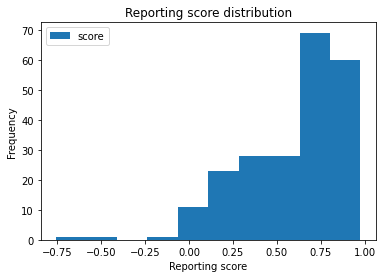

In [18]:
ax = reporting_metric.plot(y="score", kind="hist")
ax.set_xlabel("Reporting score")
ax.set_title("Reporting score distribution")
plt.savefig("figures/reporting_score_dis.png")

In [19]:
comp_df = (
    day_stat.query("Region.notna()")
    .loc[:, ["weekday", "name", "WkCasePop", "reported"]]
    .groupby(["name", "weekday"])
    .agg({"WkCasePop": "mean", "reported": "mean"})
    .reset_index()
)

In [20]:
plots = []
for country in [
    reporting_metric.nlargest(1, "score").index[0],
    reporting_metric.nsmallest(1, "score").index[0],
]:
    inc = (
        alt.Chart(comp_df.query("name==@country"))
        .mark_point(filled=True, size=66)
        .encode(
            x=alt.X(
                "weekday",
                sort=[
                    "Monday",
                    "Tuesday",
                    "Wednesday",
                    "Thursday",
                    "Friday",
                    "Saturday",
                    "Sunday",
                ],
            ),
            y=alt.Y("WkCasePop", title="7-day-incidence"),
        )
    ).properties(title=country, width=400, height=400)
    rep = (
        alt.Chart(comp_df.query("name==@country"))
        .mark_point(filled=True, size=66)
        .encode(
            x=alt.X(
                "weekday",
                sort=[
                    "Monday",
                    "Tuesday",
                    "Wednesday",
                    "Thursday",
                    "Friday",
                    "Saturday",
                    "Sunday",
                ],
            ),
            y=alt.Y("reported", title="Average reporting rate"),
        )
    ).properties(width=400, height=400)
    plots.append(alt.hconcat(inc, rep))

In [21]:
top_1_bottom_1 = alt.vconcat(*plots)

In [22]:
top_1_bottom_1.save("figures/reporting_score_top_bottom_1.png", webdriver="firefox")
top_1_bottom_1

alt.VConcatChart(...)

In [23]:
# Plot too large

# plots = []
# for region in ["AFRO", "AMRO", "EMRO", "EURO", "SEARO", "WPRO"]:
#     error_bars = (
#         alt.Chart()
#         .mark_errorbar(extent="stdev", clip=True)
#         .encode(
#             x=alt.X("weekday:N"),
#             y=alt.Y("reported", scale=alt.Scale(domain=[0, 1])),
#         )
#     )
#     points = (
#         alt.Chart()
#         .mark_point(filled=True, color="black")
#         .encode(
#             x=alt.X("weekday:N"),
#             y=alt.Y("mean(reported)", scale=alt.Scale(domain=[0, 1])),
#         )
#     )
#     line = (
#         alt.Chart(pd.DataFrame({"reported": [0.5]}))
#         .mark_rule(color="red")
#         .encode(y="reported")
#     )
#     plots.append(
#         alt.layer(points, error_bars, line, data=day_stat.query(f"Region=='{region}'"))
#         .facet("ISO2:N", columns=6)
#         .properties(title=region)
#     )
# alt.vconcat(*plots)

In [24]:
SEED = 19

0.085 --> 0.066 --> 0.065 --> 0.066 --> 


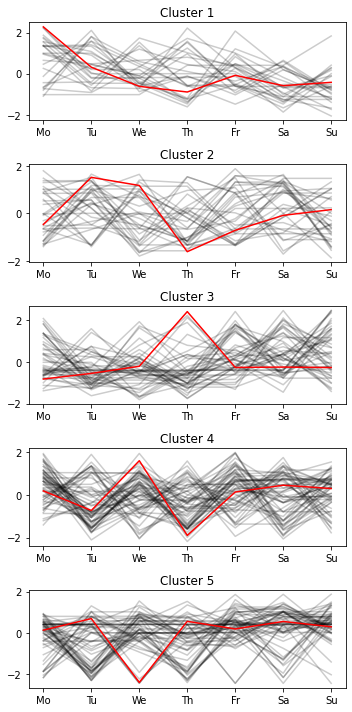

In [25]:
X_train_raw = np.vstack(
    list(
        day_stat.query("Region.notna()")
        .groupby(["name", "weekday"])
        .agg({"reported": "mean"})
        .reset_index()
        .groupby(["name"])["reported"]
        .apply(np.array)
        .values
    )
).reshape(-1, 7, 1)

# For this method to operate properly, prior scaling is required
X_train = TimeSeriesScalerMeanVariance().fit_transform(X_train_raw)
sz = X_train.shape[1]

clusters = 5
ks = KShape(n_clusters=clusters, verbose=True, random_state=SEED)
y_pred = ks.fit_predict(X_train)

f, axs = plt.subplots(2, 2, figsize=(5, 10))
for yi in range(clusters):
    plt.subplot(clusters, 1, 1 + yi)
    for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=0.2)
    plt.plot(
        [
            "Mo",
            "Tu",
            "We",
            "Th",
            "Fr",
            "Sa",
            "Su",
        ],
        ks.cluster_centers_[yi].ravel(),
        "r-",
    )
    plt.title("Cluster %d" % (yi + 1))

plt.tight_layout()
plt.show()

Using clustering with temporal-specifc metrics does not yield meaningfull clusters. My impression is that the necessary scaling which is applied along each time series and not along the whole data, might remove much of the important properties of the reporting behavior (100% and 50% reporting rate at each day will be scaled to 0 for this country).

Thus, I use classical clustering. I choose to use spectral clustering since it detects complex and also not well-seperated clusters which I expect with this data and give examples for in the beginning of the notebook.

Cluster size was determined by trying out several sizes from 2 to 12 clusters.

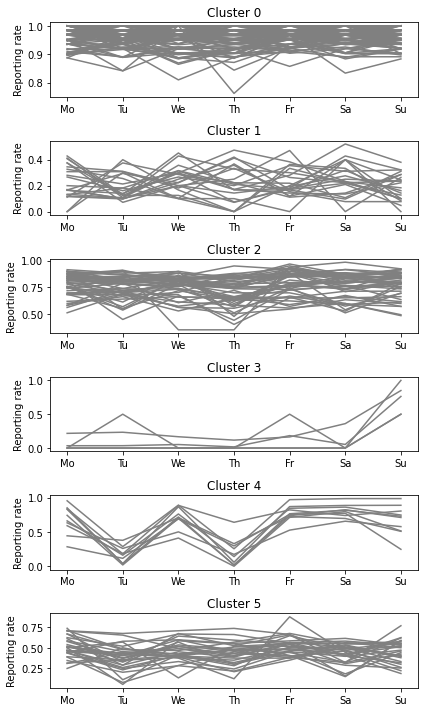

In [26]:
binary_stat = (
    day_stat.groupby(["name", "weekday"])
    .agg({"reported": "mean"})
    .groupby("name")["reported"]
    .apply(np.array)
)

binary_stat_iso2 = binary_stat.index

binary_stat_mat = np.vstack(list(binary_stat.values))

n_clusters = 6
clustering = SpectralClustering(
    n_clusters=n_clusters, assign_labels="discretize", random_state=SEED
)  # I chose to keep the default values and only used a more robust initialization method
clustering.fit(binary_stat_mat)

fig, axs = plt.subplots(n_clusters)
fig.set_size_inches(6, 10)
for cluster in range(n_clusters):
    for cluster_arr in np.argwhere(clustering.labels_ == cluster).ravel():
        axs[cluster].plot(
            [
                "Mo",
                "Tu",
                "We",
                "Th",
                "Fr",
                "Sa",
                "Su",
            ],
            binary_stat_mat[cluster_arr],
            color="grey",
        )
        axs[cluster].set_title(f"Cluster {cluster}")
        axs[cluster].set_ylabel(f"Reporting rate")
fig.tight_layout()
plt.savefig("figures/clustering_binary_reporting.png")

This method yields much better, coherent clusters. We see that the largest cluster (0) shows a large and stable reporting frequency. The other show less frequent or less stable reporting. Let's look at the countries behind these clusters.

In [27]:
binary_stat.iloc[np.argwhere(clustering.labels_ == 0).ravel()].index

Index(['Afghanistan', 'Albania', 'Algeria', 'Argentina', 'Armenia',
       'Australia', 'Austria', 'Azerbaijan', 'Bahrain', 'Bangladesh',
       ...
       'Tajikistan', 'Tunisia', 'Turkey', 'Ukraine', 'United Arab Emirates',
       'United Kingdom of Great Britain and Northern Ireland',
       'United States of America', 'Uruguay', 'Uzbekistan',
       'Venezuela (Bolivarian Republic of)'],
      dtype='object', name='name', length=107)

In [28]:
binary_stat.iloc[np.argwhere(clustering.labels_ == 1).ravel()].index

Index(['Anguilla', 'Botswana', 'Dominica', 'Falkland Islands (Malvinas)',
       'Fiji', 'Greenland', 'Grenada', 'Guadeloupe', 'Holy See', 'Martinique',
       'Mauritius', 'Montserrat', 'New Caledonia', 'Northern Mariana Islands',
       'Saba', 'Saint Barthélemy', 'Saint Kitts and Nevis',
       'Saint Martin (French part)', 'Saint Pierre and Miquelon',
       'Sint Eustatius', 'Solomon Islands', 'Virgin Islands (British)'],
      dtype='object', name='name')

In [29]:
binary_stat.iloc[np.argwhere(clustering.labels_ == 2).ravel()].index

Index(['Andorra', 'Angola', 'Bahamas', 'Barbados', 'Belize', 'Bhutan',
       'Burkina Faso', 'Burundi', 'Cabo Verde', 'Chad',
       'Congo, Democratic Republic of the', 'Côte d'Ivoire', 'Djibouti',
       'El Salvador', 'Ghana', 'Gibraltar', 'Guam', 'Guinea', 'Guyana',
       'Haiti', 'Iceland', 'Libya', 'Liechtenstein', 'Madagascar', 'Malawi',
       'Mali', 'Mauritania', 'Monaco', 'Mongolia', 'Myanmar', 'Namibia',
       'New Zealand', 'Niger', 'Oman', 'San Marino', 'Sierra Leone',
       'South Sudan', 'Sudan', 'Syrian Arab Republic', 'Thailand', 'Togo',
       'Trinidad and Tobago', 'Uganda', 'Viet Nam', 'Virgin Islands (U.S.)',
       'Yemen', 'Zambia', 'Zimbabwe'],
      dtype='object', name='name')

In [30]:
binary_stat.iloc[np.argwhere(clustering.labels_ == 3).ravel()].index

Index(['Benin', 'Marshall Islands', 'Nicaragua', 'Samoa', 'Vanuatu'], dtype='object', name='name')

In [31]:
binary_stat.iloc[np.argwhere(clustering.labels_ == 4).ravel()].index

Index(['Aruba', 'Bonaire', 'Curaçao', 'French Guiana', 'French Polynesia',
       'Gabon', 'Mayotte', 'Norway', 'Réunion', 'Sint Maarten (Dutch part)'],
      dtype='object', name='name')

In [32]:
binary_stat.iloc[np.argwhere(clustering.labels_ == 5).ravel()].index

Index(['Antigua and Barbuda', 'Bermuda', 'Brunei Darussalam', 'Cambodia',
       'Cameroon', 'Cayman Islands', 'Central African Republic', 'Comoros',
       'Congo', 'Equatorial Guinea', 'Eritrea', 'Faroe Islands', 'Gambia',
       'Guernsey', 'Guinea-Bissau', 'Isle of Man', 'Jersey',
       'Lao People's Democratic Republic', 'Lesotho', 'Liberia',
       'Papua New Guinea', 'Saint Lucia', 'Saint Vincent and the Grenadines',
       'Sao Tome and Principe', 'Seychelles', 'Somalia',
       'Tanzania, United Republic of', 'Timor-Leste',
       'Turks and Caicos Islands', 'Wallis and Futuna'],
      dtype='object', name='name')

Mostly small countries seem to be in the clusters with less good reporting. We might have a confounder. Let#s look at this using our self-developed metric.

In [33]:
pop = df.groupby("name").agg(
    {"population": lambda x: np.log(np.mean(x.values, where=np.isfinite(x.values)))}
)

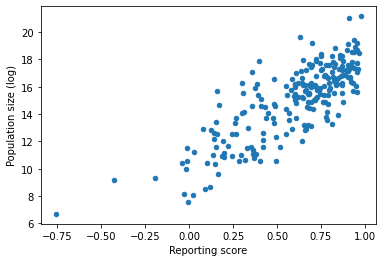

In [34]:
ax = reporting_metric.merge(pop, left_index=True, right_index=True, how="left").plot(
    y="population", x="score", kind="scatter"
)
ax.set_ylabel("Population size (log)")
ax.set_xlabel("Reporting score")
fig = ax.get_figure()
fig.savefig("figures/pop_score_corr.png")

Population and reporting reliabilty show some correlation and thus this metric and maybe other metrics should be inspected considering country size.

## Relative reporting behavior

In the following, we are going to look at the proportion of new cases along weekdays by the sum of all reports during this week. If reporting were stable, the proportion should stay stable. If there are reporting lags, large amounts of reports are made up for during the week which results in a larger proportion of cases during this weekday compare to all cases during this week.

In [35]:
weekday_stat_reg = (
    day_stat.groupby(["Region", "name", "week", "weekday"])
    .agg({"Confirmed": "sum"})
    .reset_index()
)
weekday_stat_reg = weekday_stat_reg.assign(
    confirmed_relative=lambda x: x["Confirmed"]
    / x.groupby(["Region", "name", "week"])["Confirmed"].transform("sum")
)

In [36]:
weekday_stat_reg.head()

,Region,name,week,weekday,Confirmed,confirmed_relative
0,AFRO,Algeria,1,Friday,0,0.000000
1,AFRO,Algeria,1,Monday,0,0.000000
2,AFRO,Algeria,1,Saturday,537,0.306157
3,AFRO,Algeria,1,Sunday,256,0.145952
4,AFRO,Algeria,1,Thursday,475,0.270810


In [37]:
error_bars = (
    alt.Chart()
    .mark_errorbar(extent="stdev", clip=True)
    .encode(
        x=alt.X(
            "weekday:N",
            sort=[
                "Monday",
                "Tuesday",
                "Wednesday",
                "Thursday",
                "Friday",
                "Saturday",
                "Sunday",
            ],
        ),
        y=alt.Y("confirmed_relative"),
    )
)

points = (
    alt.Chart()
    .mark_point(filled=True)
    .encode(
        x=alt.X(
            "weekday:N",
            sort=[
                "Monday",
                "Tuesday",
                "Wednesday",
                "Thursday",
                "Friday",
                "Saturday",
                "Sunday",
            ],
        ),
        y=alt.Y("mean(confirmed_relative)", title="Relative reporting rate"),
    )
)


relative_global = alt.layer(
    points,
    error_bars,
    data=weekday_stat_reg.query("Region.notna() and Region!='OTHER'").loc[
        :, ["weekday", "Region", "confirmed_relative"]
    ],
).properties(width=400, height=400)
relative_global.save("figures/relative_global.png", webdriver="firefox")
relative_global

alt.LayerChart(...)

Relative reporting rate looks similar to the binary reporting rate. Rate is higher from We-Fr and lowest on Su-Mo. Again, the errorbar is large. Let's see if we can explain why.

In [38]:
error_bars = (
    alt.Chart()
    .mark_errorbar(extent="stdev", clip=True)
    .encode(
        x=alt.X(
            "weekday:N",
            sort=[
                "Monday",
                "Tuesday",
                "Wednesday",
                "Thursday",
                "Friday",
                "Saturday",
                "Sunday",
            ],
        ),
        y=alt.Y("confirmed_relative"),
    )
)

points = (
    alt.Chart()
    .mark_point(filled=True)
    .encode(
        x=alt.X(
            "weekday:N",
            sort=[
                "Monday",
                "Tuesday",
                "Wednesday",
                "Thursday",
                "Friday",
                "Saturday",
                "Sunday",
            ],
        ),
        y=alt.Y("mean(confirmed_relative)", title="Relative reporting rate"),
    )
)


relative_regional = alt.layer(
    points,
    error_bars,
    data=weekday_stat_reg.query("Region.notna() and Region!='OTHER'").loc[
        :, ["weekday", "Region", "confirmed_relative"]
    ],
).facet("Region:N", columns=3)
relative_regional.save("figures/relative_regional.png", webdriver="firefox")
relative_regional

alt.FacetChart(...)

When looking at the relative reporting rate from a regional perspective, the reporting behavior is similar to the global one with small differences. EURO, SEARO, and EMRO again have lower error bars than the other regions. The reporting curve also looks similar, but with deviations in EURO and EMRO. EURO has a larger spread in the reporting rate from Monday to Thursday. EMRO is the only region where Monday has not the lowerd relative reporting rate. This might be due many Arabic countries having Sunday as a regular working day.

In [39]:
# PLot too large

# plots = []
# for region in ['AFRO', 'AMRO', 'EMRO', 'EURO', 'SEARO', 'WPRO']:
#     error_bars = alt.Chart().mark_errorbar(extent='stdev', clip=True).encode(
#         x=alt.X("weekday:N"),
#         y=alt.Y("confirmed_relative"),
#     )

#     points = alt.Chart().mark_point(filled=True).encode(
#         x=alt.X("weekday:N"),
#         y=alt.Y("mean(confirmed_relative)", scale=alt.Scale(domain=[0,1])),
#     )


#     plots.append(alt.layer(points, error_bars, data=weekday_stat_reg.query(f"Region=='{region}'")).facet("ISO2:N", columns=6).properties(title=region))

# alt.vconcat(*plots)

0.057 --> 0.062 --> 


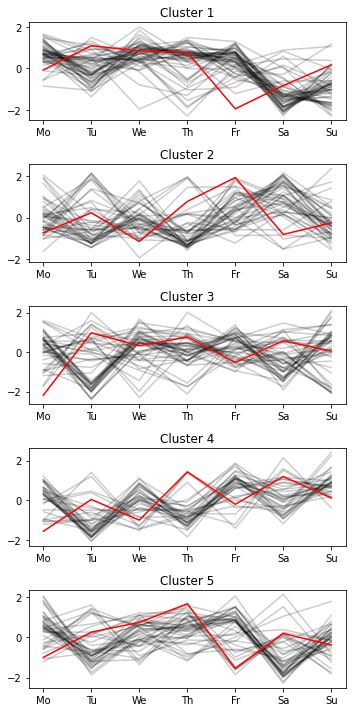

In [40]:
X_train_raw_relative = np.vstack(
    list(
        weekday_stat_reg.query("Region.notna()")
        .groupby(["name", "weekday"])
        .agg({"confirmed_relative": "mean"})
        .reset_index()
        .groupby(["name"])["confirmed_relative"]
        .apply(np.array)
        .values
    )
).reshape(-1, 7, 1)

X_train_raw_relative = X_train_raw_relative[
    np.all(np.isfinite(X_train_raw_relative), axis=1).reshape(-1)
]
# For this method to operate properly, prior scaling is required
X_train = TimeSeriesScalerMeanVariance().fit_transform(X_train_raw_relative)

clusters = 5
# kShape clustering
ks = KShape(n_clusters=clusters, verbose=True, random_state=SEED)
X_train = X_train[np.all(np.isfinite(X_train), axis=1).reshape(-1)]
y_pred = ks.fit_predict(X_train)

f, axs = plt.subplots(2, 2, figsize=(5, 10))
for yi in range(clusters):
    plt.subplot(clusters, 1, 1 + yi)
    for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=0.2)
    plt.plot(
        ["Mo", "Tu", "We", "Th", "Fr", "Sa", "Su"],
        ks.cluster_centers_[yi].ravel(),
        "r-",
    )
    plt.title("Cluster %d" % (yi + 1))

plt.tight_layout()
plt.show()

As before, the clusters using temporal-specific clustering don't look homogenous. While the same possible explanation applies in this example, I wan't to show one more possible explanation for the poor clusters.

When I looked at the reporting rates on a country level (commented-out code), I found many patterns and thought about quantifying the amount of patterns. I wrote a simple clustering algorithm assign two labels, starting with the minimum and maximum value in an array as the two first clusters. This way, I would find the most extreme patterns only (reporting every day and only reporting once). I cluster each country's average reporting rate and sum the amount of unique patterns found with this clustering approach and divivde it by the amount of all possible clusters. If the value is high, we have many unique patterns making it hard to find good looking clusters.

In [41]:
def cluster(array: np.array) -> np.array:
    """Clusters values in 1-D array into two groups."""
    min_centroid = array.min()
    max_centroid = array.max()
    centers = np.array(
        [
            max_centroid,
            min_centroid,
        ]
    )

    while True:
        labels = pairwise_distances_argmin(array.reshape(-1, 1), centers.reshape(-1, 1))

        new_centers = np.array([array[labels == i].mean(0) for i in range(2)])

        if np.all(centers == new_centers):
            break
        centers = new_centers
    return labels

In [42]:
clusters = []
for arr in X_train_raw:
    try:
        clusters.append(cluster(arr))
    except:
        continue

uniques = np.unique(clusters, axis=0)
print(
    uniques.shape[0] / 2 ** 7,
    "% of all possible clusters for binary reporting are found using min-max-clustering",
)

0.6875 % of all possible clusters for binary reporting are found using min-max-clustering


In [43]:
clusters = []
for arr in X_train_raw_relative:
    try:
        clusters.append(cluster(arr))
    except:
        continue

uniques = np.unique(clusters, axis=0)
print(
    uniques.shape[0] / 2 ** 7,
    "% of all possible clusters for relative reporting are found using min-max-clustering",
)

0.6171875 % of all possible clusters for relative reporting are found using min-max-clustering


We see that we have a large amount of unique clusters in this small data set. Thus, good clustering might be hard. Again, I also applied spectral clustering which showed more robust results and allows us to cluster more complicated arrays.

In [44]:
weekday_stat_reg = (
    day_stat.query("day>@pd.to_datetime('2021-01-01')")
    .groupby(["Region", "name", "week", "weekday"])
    .agg({"Confirmed": "sum"})
    .reset_index()
)
weekday_stat_reg = weekday_stat_reg.assign(
    confirmed_relative=lambda x: x["Confirmed"]
    / x.groupby(["Region", "name", "week"])["Confirmed"].transform("sum")
)

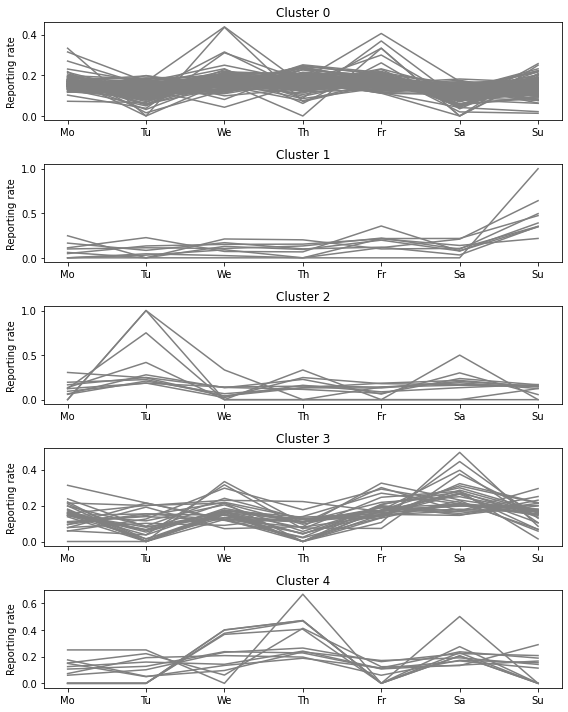

In [45]:
relative_stat = (
    weekday_stat_reg.groupby(["name", "weekday"])
    .agg({"confirmed_relative": "mean"})
    .groupby("name")["confirmed_relative"]
    .apply(np.array)
)
relative_stat_iso2 = relative_stat.index
relative_stat_mat = np.vstack(list(relative_stat.values))
is_finite = np.argwhere(np.isfinite(relative_stat_mat).all(axis=1)).ravel()
relative_stat_mat = relative_stat_mat[is_finite]

n_clusters = 5
clustering = SpectralClustering(
    n_clusters=n_clusters, assign_labels="discretize", random_state=SEED
)
clustering.fit(relative_stat_mat)

fig, axs = plt.subplots(n_clusters)
fig.set_size_inches(8, 10)
for cluster in range(n_clusters):
    for cluster_arr in np.argwhere(clustering.labels_ == cluster).ravel():
        axs[cluster].plot(
            ["Mo", "Tu", "We", "Th", "Fr", "Sa", "Su"],
            relative_stat_mat[cluster_arr],
            color="grey",
        )
        axs[cluster].set_title(f"Cluster {cluster}")
        axs[cluster].set_ylabel("Reporting rate")
fig.tight_layout()
plt.savefig("figures/relative_reporting_clustering.png")

In [46]:
relative_stat.iloc[np.argwhere(clustering.labels_ == 0).ravel()].index

Index(['Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola',
       'Antigua and Barbuda', 'Argentina', 'Armenia', 'Australia', 'Austria',
       ...
       'Uganda', 'Ukraine', 'United Arab Emirates',
       'United Kingdom of Great Britain and Northern Ireland', 'Uruguay',
       'Uzbekistan', 'Venezuela (Bolivarian Republic of)',
       'Virgin Islands (British)', 'Virgin Islands (U.S.)',
       'Wallis and Futuna'],
      dtype='object', name='name', length=152)

In [47]:
relative_stat.iloc[np.argwhere(clustering.labels_ == 1).ravel()].index

Index(['Benin', 'Bermuda', 'Cayman Islands', 'Comoros', 'Djibouti',
       'Falkland Islands (Malvinas)', 'Gabon', 'New Zealand', 'Rwanda'],
      dtype='object', name='name')

In [48]:
relative_stat.iloc[np.argwhere(clustering.labels_ == 2).ravel()].index

Index(['Finland', 'Guatemala', 'Luxembourg', 'Montenegro', 'Nicaragua',
       'North Macedonia', 'Norway', 'Sint Maarten (Dutch part)', 'South Sudan',
       'United States of America', 'Viet Nam'],
      dtype='object', name='name')

In [49]:
relative_stat.iloc[np.argwhere(clustering.labels_ == 3).ravel()].index

Index(['Aruba', 'Belgium', 'Bonaire', 'Botswana', 'Bulgaria', 'Cameroon',
       'Cuba', 'Cyprus', 'Denmark', 'Egypt', 'Equatorial Guinea',
       'French Guiana', 'French Polynesia', 'Gambia', 'Greenland',
       'Guadeloupe', 'Hungary', 'Ireland', 'Jersey', 'Kyrgyzstan', 'Lebanon',
       'Lesotho', 'Liberia', 'Mauritania', 'Mauritius',
       'Northern Mariana Islands', 'Saba', 'Saint Martin (French part)',
       'Sierra Leone', 'Sudan', 'Vanuatu'],
      dtype='object', name='name')

In [50]:
relative_stat.iloc[np.argwhere(clustering.labels_ == 4).ravel()].index

Index(['Anguilla', 'Bhutan', 'Colombia', 'Grenada', 'Guyana', 'Malta',
       'Myanmar', 'Portugal', 'Réunion', 'Saint Kitts and Nevis',
       'Saint Lucia', 'Sweden'],
      dtype='object', name='name')

## Conclusion
With the little data availabe through WHO, I was able to classify countries by their reporting behavior in two dimensions, the binary and relative reporting behavior.

I detected overall properties in reporting on large spatial levels and country-level properties by clustering. While the majority of countries were very similar and reliable in reporting, I detected outliers. This will help public-health agents to relativize data made by these countries. Furthermore, I was able to quantify the spread between incidence and reporting frequency which helps to classify countries in good and sporadic reporter.

I think developing the reporting reliability metric was the most interesting for me since I was able to develop a method from scratch to help formalise an intuition I had about the data and then seeing it work felt rewarding.

But when looking at the correlation of the metric and the population size, and the clustering of the binary reporting rate, it is striking that smaller countries receive a smaller score or are found within less optimal clusters. I think this makes sense since large countries will be more likely to report new cases no matter how severe the outbreak in this country is. The binary reporting rate and therefore the metric have a bias towards countries with large populations. This confounder needs to be addressed to make the metric fairer. 

The relative reporting behavior clustering seems to be less affected by population size and can be used meanwhile to assess reporting behavior. Incoporating the relative reporting behavior into my custom metric might improve. Furthermore, reported cases are dependet on conducted tests. The metric should include testing rate as another factor where more testing is rewarded by the metric.